In [13]:
import glob
from aiapy.calibrate import register, update_pointing
import numpy as np
from tqdm import tqdm
import matplotlib.cm as cm
import matplotlib.colorbar as colorbar
import scipy.ndimage as ndimage
import matplotlib.colors as colors
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from mpl_toolkits.mplot3d import Axes3D  # Required even if unused directly
import os
import gzip
import requests
import urllib.request
from bs4 import BeautifulSoup
from sunpy.map import Map
from sunpy.coordinates import sun
import pfsspy
import pfsspy.tracing as tracing
from sunpy.sun import constants as const
import astropy.units as u
from astropy.coordinates import SkyCoord
from astropy.visualization import ImageNormalize
from astropy.visualization import SqrtStretch, LogStretch
import ipywidgets as widgets
from IPython.display import display, clear_output

import sunpy
import logging
sunpy.log.setLevel(logging.WARNING) # Set SunPy's logger to only show WARNING or above

# Construct the full path to the scripts directory
script_path = os.path.abspath('./scripts')

# Add the scripts directory to sys.path
import sys
if script_path not in sys.path:
    sys.path.append(script_path)

import solar_data_utils as myfuncs
import importlib
importlib.reload(myfuncs) # Reload to update with new changes

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import ipywidgets as widgets
from IPython.display import display

data_dir = '/home/mnedal/data'

# mydatetime       = '2025-03-26T00:00'
mydatetime       = '2011-06-07T00:00'
YEAR, MONTH, DAY = mydatetime.split('T')[0].split('-')
HOUR, MINUTE     = mydatetime.split('T')[1].split(':')

## Load lv1 AIA images

In [4]:
aia_files = sorted(glob.glob(f'{data_dir}/AIA/193A/highres/lv1/aia.lev1.193A_{YEAR}_{MONTH}_{DAY}T*_lev1.fits'))

# upgrade AIA maps to lv1.5
upgraded_maps = []
with tqdm(total=len(aia_files), desc='upgrading AIA maps lv1 --> lv1.5 ...') as pbar:
    for i, file in enumerate(aia_files):
        try:
            m = sunpy.map.Map(file)
            # update the metadata of the map to the most recent pointing
            m = update_pointing(m)
            # scale the image to the 0.6"/pix
            # and derotate the image such that the y-axis is aligned with solar North
            m = register(m)
            # exposure time normalization
            m = m / m.exposure_time
            upgraded_maps.append(m)
            # export the promoted map
            path = aia_files[i]
            path = path.replace('/lv1/', '/lv15/')
            path = path.replace('lev1', 'lev15')
            m.save(path)
        except:
            pass
        pbar.update(1)

assert len(aia_files) == len(upgraded_maps), 'Not all AIA maps have been upgraded!'

upgrading AIA maps lv1 --> lv1.5 ...:   0%|                                           | 0/187 [00:00<?, ?it/s]WARNING: VerifyWarning: Invalid 'BLANK' keyword in header.  The 'BLANK' keyword is only applicable to integer data, and will be ignored in this HDU. [astropy.io.fits.hdu.image]
2025-07-08 22:39:15 - astropy - WARNING: VerifyWarning: Invalid 'BLANK' keyword in header.  The 'BLANK' keyword is only applicable to integer data, and will be ignored in this HDU.
upgrading AIA maps lv1 --> lv1.5 ...:   1%|▏                                  | 1/187 [00:08<26:30,  8.55s/it]WARNING: VerifyWarning: Invalid 'BLANK' keyword in header.  The 'BLANK' keyword is only applicable to integer data, and will be ignored in this HDU. [astropy.io.fits.hdu.image]
2025-07-08 22:39:23 - astropy - WARNING: VerifyWarning: Invalid 'BLANK' keyword in header.  The 'BLANK' keyword is only applicable to integer data, and will be ignored in this HDU.
upgrading AIA maps lv1 --> lv1.5 ...:   1%|▎                    

## Load lv1.5 AIA images, if exist

In [5]:
aia_files = sorted(glob.glob(f'{data_dir}/AIA/193A/highres/lv15/aia.lev15.193A_{YEAR}_{MONTH}_{DAY}T*_lev15.fits'))

upgraded_maps = []
for i, file in enumerate(aia_files):
    m = sunpy.map.Map(file)
    upgraded_maps.append(m)

In [6]:
len(upgraded_maps)

187

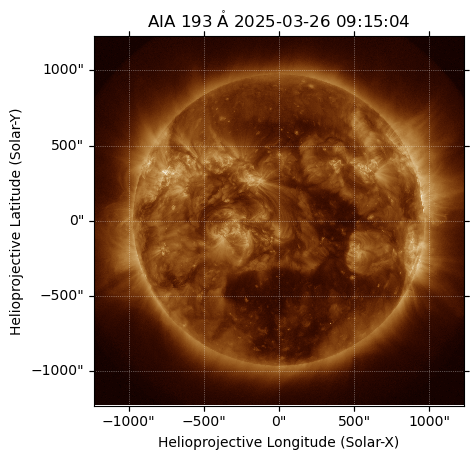

In [7]:
# preview one map as a sanity check
upgraded_maps[0].plot()

In [8]:
# apply running difference
assert len(upgraded_maps) > 6, 'Need at least 6 images for running difference!'

running_diff_maps = []
with tqdm(total=len(upgraded_maps), desc='Applying running difference ...') as pbar:
    for i in range(5, len(upgraded_maps)):
        m0 = upgraded_maps[i-5]
        m1 = upgraded_maps[i]
        diff = m1.quantity - m0.quantity
        smoothed = ndimage.gaussian_filter(diff, sigma=[3,3])
        diff_map = sunpy.map.Map(smoothed, m1.meta)
        diff_map.plot_settings['norm'] = colors.Normalize(vmin=-50, vmax=50)
        running_diff_maps.append(diff_map)
        pbar.update(1)

Applying running difference ...:  97%|████████████████████████████████████▉ | 182/187 [04:07<00:06,  1.36s/it]


In [9]:
len(running_diff_maps)

182

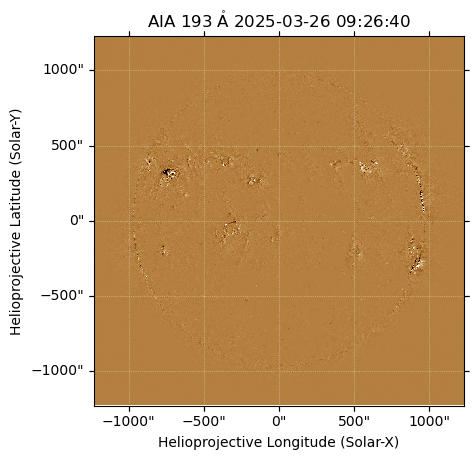

In [10]:
# preview one map as a sanity check
running_diff_maps[40].plot()

In [39]:
# another way to highlight details in the maps ...
running_ratio_maps = myfuncs.apply_runratio(upgraded_maps, vmin=0, vmax=2)

Applying running ratio ...:  99%|██████████████████████████████████████████▋| 149/150 [00:34<00:00,  4.37it/s]


In [11]:
# preview the maps interactively
maps_type = running_diff_maps # running_diff_maps, running_ratio_maps

current_index = widgets.IntText(value=0, layout=widgets.Layout(width='50px'))

output = widgets.Output()

def show_map(index):
    with output:
        clear_output(wait=True)
        if 0 <= index < len(maps_type):
            m = maps_type[index]
            fig = plt.figure(figsize=[5,5])
            ax  = fig.add_subplot(projection=m)
            m.plot(axes=ax)
            ax.grid(False)
            plt.show()
        else:
            print('Index out of range.')

def first_map(b): current_index.value = 0
def last_map(b): current_index.value = len(maps_type) - 1
def next_map(b): 
    if current_index.value < len(maps_type) - 1:
        current_index.value += 1
def prev_map(b): 
    if current_index.value > 0:
        current_index.value -= 1

current_index.observe(lambda change: show_map(change['new']), names='value')

btn_first = widgets.Button(description='First')
btn_last = widgets.Button(description='Last')
btn_next = widgets.Button(description='Next')
btn_prev = widgets.Button(description='Previous')

btn_first.on_click(first_map)
btn_last.on_click(last_map)
btn_next.on_click(next_map)
btn_prev.on_click(prev_map)

controls = widgets.HBox([btn_first, btn_prev, current_index, btn_next, btn_last])

display(controls, output)

# Show initial map
show_map(current_index.value)

Output()

## Coronal magnetic field extrapolation using the PFSS model

In [33]:
# show the links of the GONG files
gong_url = 'https://gong2.nso.edu/oQR/zqs/%s%s/mrzqs%s%s%s/' %(YEAR, MONTH, YEAR[-2:], MONTH, DAY)
list_gong_links = myfuncs.find_links(url=gong_url)

# show what you've found
for i, link in enumerate(list_gong_links):
    print(i, link)

0 ?C=N;O=D
1 ?C=M;O=A
2 ?C=S;O=A
3 ?C=D;O=A
4 /oQR/zqs/201106/
5 mrzqs110607t0554c2111_281.fits.gz
6 mrzqs110607t1154c2111_278.fits.gz
7 mrzqs110607t1754c2111_274.fits.gz
8 mrzqs110607t2354c2111_271.fits.gz


/net/maedoc.ap.dias.ie/maedoc/home_cr/mnedal/repos/dias_work/scripts/solar_data_utils.py:637: GuessedAtParserWarning:

No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 637 of the file /net/maedoc.ap.dias.ie/maedoc/home_cr/mnedal/repos/dias_work/scripts/solar_data_utils.py. To get rid of this warning, pass the additional argument 'features="lxml"' to the BeautifulSoup constructor.




In [34]:
gong_file_index = 6
gong_filename = list_gong_links[gong_file_index]

if not os.path.exists(data_dir + gong_filename[:-3]) and not os.path.exists(data_dir + gong_filename):
    urllib.request.urlretrieve(url=gong_url+gong_filename, filename=data_dir+gong_filename)

if not os.path.exists(data_dir + gong_filename[:-3]):
    with gzip.open(data_dir + gong_filename, 'rb') as f:
        with open(data_dir + gong_filename[:-3], 'wb') as g:
            g.write(f.read())

# make a sunpy map of the file
gong_map = Map(data_dir + gong_filename[:-3])

# fix a bug in the GONG map file
if 'cunit1' not in gong_map.meta:
    gong_map.meta['cunit1'] = u.deg

In [35]:
# Model the PFSS field lines
nrho     = 50  # number of rho grid points
rss      = 3   # source surface radius
pfss_in  = pfsspy.Input(gong_map, nrho, rss)
pfss_out = pfsspy.pfss(pfss_in)

num_footpoints_lat = 30
num_footpoints_lon = 60
r = 1.15*const.radius

lat = np.linspace(np.radians(-90), np.radians(90), num_footpoints_lat, endpoint=False)
lon = np.linspace(np.radians(-180), np.radians(180), num_footpoints_lon, endpoint=False)

lat, lon = np.meshgrid(lat, lon, indexing='ij')
lat, lon = lat.ravel()*u.rad, lon.ravel()*u.rad

# Make a 2D grid from these 1D points 
seeds  = SkyCoord(lon, lat, r, frame=pfss_out.coordinate_frame)
tracer = tracing.FortranTracer()
# tracer = tracing.FortranTracer(max_steps=20000, step_size=1)
field_lines = tracer.trace(seeds, pfss_out)

/mnt/mnedal_data/anaconda3/envs/dias/lib/python3.10/site-packages/pfsspy/output.py:95: UserWarning:

Could not parse unit string "Gauss" as a valid FITS unit.
See https://fits.gsfc.nasa.gov/fits_standard.html for the FITS unit standards.

/mnt/mnedal_data/anaconda3/envs/dias/lib/python3.10/site-packages/pfsspy/tracing.py:180: UserWarning:

At least one field line ran out of steps during tracing.
You should probably increase max_steps (currently set to auto) and try again.



Carrington longitude: 344.23


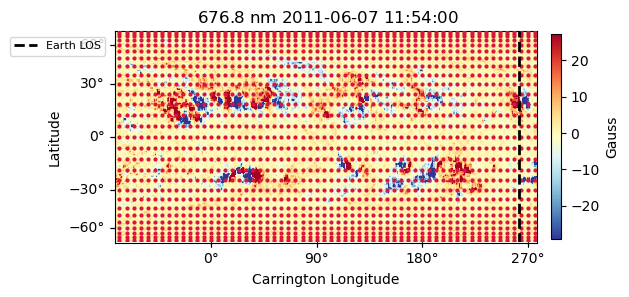

In [36]:
# find where is the Earth LOS on GONG map
hp_lon = 0*u.arcsec
hp_lat = np.linspace(-90, 90, 1)*u.arcsec

# Make a 2D grid from these 1D points
lon, lat  = np.meshgrid(hp_lon, hp_lat)
earth_los = SkyCoord(lon.ravel(), lat.ravel(), frame=gong_map.coordinate_frame)
los_lon   = sun.L0(time=gong_map.meta['date-obs']).value
print(f'Carrington longitude: {los_lon:.2f}')

fig = plt.figure()
ax  = plt.subplot(projection=gong_map)
gon = gong_map.plot(cmap='RdYlBu_r', clip_interval=[1, 99]*u.percent)

ax.plot_coord(seeds, color='crimson', marker='o', linewidth=0, markersize=2)
# ax.plot_coord(earth_los, color='k', marker='*', linewidth=0, markersize=5, label='Earth LOS')
ax.axvline(x=los_lon, color='black', linestyle='--', linewidth=2, label='Earth LOS')

ax.legend(loc='upper right', prop={'size':8}, bbox_to_anchor=(-0.01, 1))
fig.colorbar(gon, fraction=0.023, pad=0.03, label=pfss_in.map.meta['bunit'])
fig.tight_layout()
plt.show()

/tmp/ipykernel_2175426/982301172.py:16: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('RdYlBu_r')  # gray, RdBu_r, RdYlBu_r, seismic, bwr for polarity
Plotting the field lines: 100%|████████████████████████████████████████████| 300/300 [00:02<00:00, 140.65it/s]


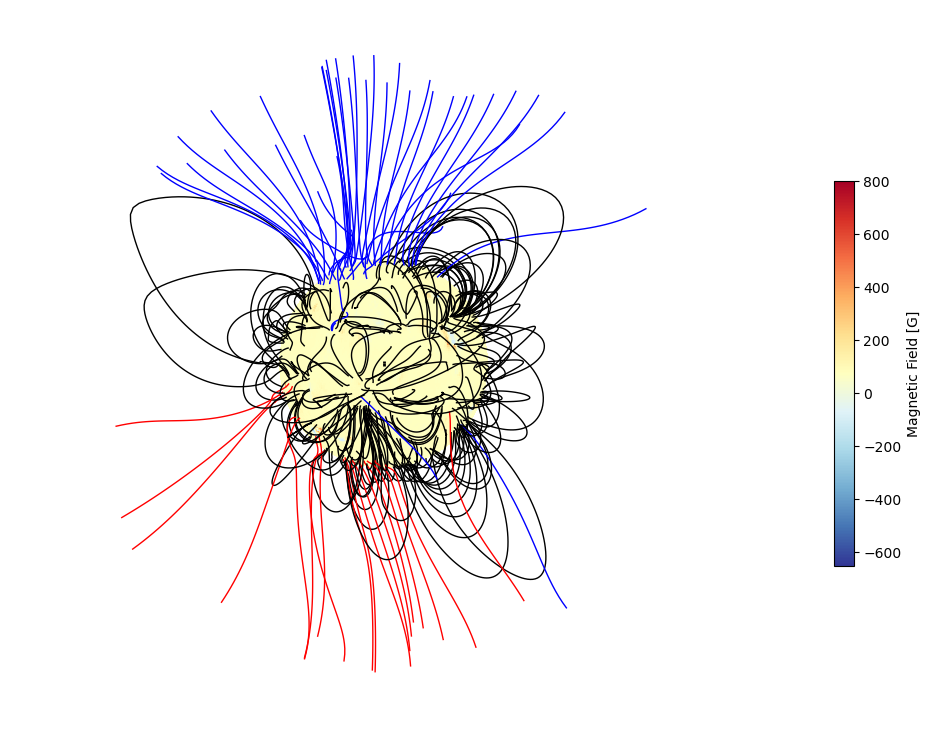

In [9]:
# Make the GONG sphere surface coordinates
theta, phi = np.mgrid[0:np.pi:180j, 0:2*np.pi:360j]
x = np.sin(theta) * np.cos(phi)
y = np.sin(theta) * np.sin(phi)
z = np.cos(theta)

# Normalize the GONG data
gong_data = gong_map.data.astype(np.float32)
gong_data = np.nan_to_num(gong_data, nan=0.0)  # Remove NaNs

# Normalize for color mapping
abs_max = np.max(np.abs(gong_data))
normed_data = (gong_data + abs_max) / (2 * abs_max)

# Choose colormap (e.g., magnetogram style)
cmap = cm.get_cmap('RdYlBu_r')  # gray, RdBu_r, RdYlBu_r, seismic, bwr for polarity
colors = cmap(normed_data)

# If you’re using a diverging colormap (e.g. 'RdBu_r'), it’s better to center the normalization around 0
abs_max = np.max(np.abs(gong_data))
norm = Normalize(vmin=-abs_max, vmax=abs_max)
norm = Normalize(vmin=gong_data.min(), vmax=gong_data.max())

mappable = cm.ScalarMappable(cmap=cmap, norm=norm)
mappable.set_array([])  # Required dummy input

# Plot
fig = plt.figure(figsize=[10,8])
ax = fig.add_subplot(111, projection='3d', computed_zorder=False)
ax.plot_surface(x, y, z, facecolors=colors, rstride=1, cstride=1, linewidth=0,
                    antialiased=False, shade=False, label='GONG')


# Convert Carrington (lon, lat) to spherical (theta, phi) for plotting
# phi   = longitude in radians: measured from x-axis
# theta = colatitude in radians: 0 at north pole → pi at south pole
phi = np.deg2rad(los_lon)
theta = np.pi / 2  # equator

ux = np.sin(theta) * np.cos(phi)
uy = np.sin(theta) * np.sin(phi)
uz = np.cos(theta)

# Shift starting point to 2 solar radii
start_r = 1.5
end_r   = 2  # arrow will be 0.5 R☉ long

x0, y0, z0 = start_r * ux, start_r * uy, start_r * uz
dx, dy, dz = (end_r - start_r) * ux, (end_r - start_r) * uy, (end_r - start_r) * uz

# Draw Earth LOS arrow
ax.quiver(x0, y0, z0, dx, dy, dz,
          color='k', arrow_length_ratio=0.2, linewidth=2, label='Earth LOS')

# Add colorbar
fig.colorbar(mappable, ax=ax, shrink=0.5, pad=0.1, label='Magnetic Field [G]')


# Add the PFSS lines
with tqdm(total=len(field_lines), desc='Plotting the field lines') as pbar:
    for n, field_line in enumerate(field_lines):
        color = {0:'black', -1:'blue', 1:'red'}.get(field_line.polarity)
        coords = field_line.coords
        coords.representation_type = 'cartesian'
        x_line = coords.x/const.radius
        y_line = coords.y/const.radius
        z_line = coords.z/const.radius
        ax.plot3D(x_line, y_line, z_line, alpha=1, color=color, linewidth=1, zorder=100)
        pbar.update(1)



# Plot config
fig_limit = 2
ax.set_xlim(-1*fig_limit, fig_limit)
ax.set_ylim(-1*fig_limit, fig_limit)
ax.set_zlim(-1*fig_limit, fig_limit)
ax.set_box_aspect([fig_limit, fig_limit, fig_limit])
ax.view_init(elev=0, azim=los_lon)
# ax.legend(title='Surfaces', loc='upper right', prop={'size':8}, bbox_to_anchor=(-0.01, 1))
ax.set_axis_off()
for axis in 'xyz':
    getattr(ax, 'set_{}label'.format(axis))(axis+' [R$_\odot]$')
fig.tight_layout()
plt.show()

## Slide controllers

In [82]:
plot_out = widgets.Output()

def plot_interactive_shell_plotly(n_lon_radial=30, n_lat_radial=30,
                                  radial_length=3,
                                  shell_lon_deg=90, shell_lat_deg=0,
                                  b_major=0.7, b_minor=0.7,
                                  shell_mesh_res=50,
                                  show_radials=False, show_normals=False,
                                  show_shell=False, show_field_lines=False,
                                  show_axes=True):
    
    with plot_out:
        plot_out.clear_output(wait=True)

        fig = go.Figure()
        
        # Create the Sun (sphere)
        theta, phi = np.mgrid[0:np.pi:50j, 0:2*np.pi:50j]
        x_sun = np.sin(theta) * np.cos(phi)
        y_sun = np.sin(theta) * np.sin(phi)
        z_sun = np.cos(theta)
        
        fig.add_trace(go.Surface(
            x=x_sun, y=y_sun, z=z_sun,
            colorscale=[[0, 'orange'], [1, 'orange']],
            showscale=False,
            name='Sun',
            hoverinfo='skip'
        ))
        
        # Convert shell center position to radians
        shell_lon = np.deg2rad(shell_lon_deg)
        shell_lat = np.deg2rad(shell_lat_deg)

        xshift = np.cos(shell_lat) * np.cos(shell_lon)
        yshift = np.cos(shell_lat) * np.sin(shell_lon)
        zshift = np.sin(shell_lat)

        # Create shell surface
        theta_src, phi_src = np.mgrid[0:np.pi:complex(shell_mesh_res), 0:2*np.pi:complex(shell_mesh_res)]
        x_src = xshift + b_minor * np.sin(theta_src) * np.cos(phi_src)
        y_src = yshift + b_minor * np.sin(theta_src) * np.sin(phi_src)
        z_src = zshift + b_major * np.cos(theta_src)

        r_shell = np.sqrt(x_src**2 + y_src**2 + z_src**2)
        mask = r_shell > 1
        x_outer = x_src[mask]
        y_outer = y_src[mask]
        z_outer = z_src[mask]

        # Calculate normal vectors
        a, b, c = b_minor, b_minor, b_major
        nx = 2 * (x_outer - xshift) / (a**2)
        ny = 2 * (y_outer - yshift) / (b**2)
        nz = 2 * (z_outer - zshift) / (c**2)
        norm = np.sqrt(nx**2 + ny**2 + nz**2)
        nx /= norm
        ny /= norm
        nz /= norm

        # Create display grid (with NaN inside the Sun)
        x_display = np.copy(x_src)
        y_display = np.copy(y_src)
        z_display = np.copy(z_src)
        r_display = np.sqrt(x_display**2 + y_display**2 + z_display**2)
        x_display[r_display < 1] = np.nan
        y_display[r_display < 1] = np.nan
        z_display[r_display < 1] = np.nan

        # Radial directions - always define for theta calculations
        all_points = []
        all_dirs = []

        if show_radials:
            theta_radial, phi_radial = np.mgrid[0:np.pi:complex(n_lat_radial), 0:2*np.pi:complex(n_lon_radial)]
            rdx = np.sin(theta_radial) * np.cos(phi_radial)
            rdy = np.sin(theta_radial) * np.sin(phi_radial)
            rdz = np.cos(theta_radial)
            rdx_flat = rdx.flatten()
            rdy_flat = rdy.flatten()
            rdz_flat = rdz.flatten()
            
            for i in range(len(rdx_flat)):
                r_vec = np.array([rdx_flat[i], rdy_flat[i], rdz_flat[i]])
                r_pts = np.linspace(0, radial_length, 50)
                lx = r_pts * r_vec[0]
                ly = r_pts * r_vec[1]
                lz = r_pts * r_vec[2]
                
                fig.add_trace(go.Scatter3d(
                    x=lx, y=ly, z=lz,
                    mode='lines',
                    line=dict(color='gray', width=2),
                    showlegend=False,
                    hoverinfo='skip',
                    opacity=0.3
                ))
                
                # Store points and directions for theta calculation
                for j in range(len(r_pts)-1):
                    all_points.append([lx[j], ly[j], lz[j]])
                    all_dirs.append(r_vec)
            
            all_points = np.array(all_points)
            all_dirs = np.array(all_dirs)

        
        # Plot the magnetic field lines (placeholder - you'll need to add your field_lines data)
        if show_field_lines:
            for n, field_line in enumerate(field_lines):
                color = {0:'black', -1:'blue', 1:'red'}.get(field_line.polarity)
                coords = field_line.coords
                coords.representation_type = 'cartesian'
                x_field = coords.x/const.radius
                y_field = coords.y/const.radius  
                z_field = coords.z/const.radius
                fig.add_trace(go.Scatter3d(
                    x=x_field, y=y_field, z=z_field,
                    mode='lines',
                    line=dict(color=color, width=2),
                    showlegend=False
                ))
    
            # Calculate theta angles between normal vectors and magnetic field lines
            # First, we need the field_lines data, and const.radius is the solar radius unit
            
            # Calculate field direction vectors (tangent to field line)
            for i in range(len(x_field)-1):
                # Field point
                field_point = np.array([x_field[i], y_field[i], z_field[i]])
                all_points.append(field_point)
    
                # Field direction (tangent vector)
                field_vector = np.array([x_field[i+1] - x_field[i], 
                                        y_field[i+1] - y_field[i], 
                                        z_field[i+1] - z_field[i]])
                # Normalize field vector
                field_vector = field_vector / np.linalg.norm(field_vector)
                all_dirs.append(field_vector)
    
            # Convert to arrays for downstream use
            all_points = np.array(all_points)
            all_dirs   = np.array(all_dirs)

        
        # Calculate theta angles between normal vectors and radial directions
        theta_angles = np.zeros_like(x_outer)
        
        if len(all_points) > 0:
            for i, (x_pt, y_pt, z_pt) in enumerate(zip(x_outer, y_outer, z_outer)):
                surf_pt = np.array([x_pt, y_pt, z_pt])
                dists = np.linalg.norm(all_points - surf_pt, axis=1)
                idx = np.argmin(dists)
                radial_dir = all_dirs[idx]
                n_vec = np.array([nx[i], ny[i], nz[i]])
                cos_theta = np.dot(n_vec, radial_dir)
                cos_theta = np.clip(cos_theta, -1.0, 1.0)
                theta_angles[i] = np.degrees(np.arccos(np.abs(cos_theta)))
        else:
            theta_angles[:] = np.nan

        # Map theta to surface
        theta_surface = np.full_like(x_src, np.nan)
        valid = np.where(mask)
        for i, (r_idx, c_idx) in enumerate(zip(*valid)):
            theta_surface[r_idx, c_idx] = theta_angles[i]
        
        # Show shell with theta angle coloring
        if show_shell:
            # Add shell center marker
            fig.add_trace(go.Scatter3d(
                x=[xshift], y=[yshift], z=[zshift],
                mode='markers',
                marker=dict(size=8, color='black'),
                showlegend=False,
                name='Shell Center'
            ))
            
            # Add shell surface with theta coloring
            fig.add_trace(go.Surface(
                x=x_display, y=y_display, z=z_display,
                surfacecolor=theta_surface,
                colorscale='Viridis',
                cmin=0, cmax=90,
                opacity=1,
                showscale=True,
                colorbar=dict(
                    title=dict(text='Theta Angle (degrees)', side='right'),
                    len=0.6
                ),
                name='Shell'
            ))
        
        
        # Show normal vectors
        if show_normals:
            # Sample normals to avoid too many arrows
            step = max(1, len(x_outer) // 100)  # Show max 100 arrows
            x_norm_sample = x_outer[::step]
            y_norm_sample = y_outer[::step]  
            z_norm_sample = z_outer[::step]
            nx_sample = nx[::step] * 0.2
            ny_sample = ny[::step] * 0.2
            nz_sample = nz[::step] * 0.2
            
            # Create line segments for normal vectors
            x_lines = []
            y_lines = []
            z_lines = []
            
            for i in range(len(x_norm_sample)):
                x_lines.extend([x_norm_sample[i], x_norm_sample[i] + nx_sample[i], None])
                y_lines.extend([y_norm_sample[i], y_norm_sample[i] + ny_sample[i], None])
                z_lines.extend([z_norm_sample[i], z_norm_sample[i] + nz_sample[i], None])
            
            fig.add_trace(go.Scatter3d(
                x=x_lines,
                y=y_lines,
                z=z_lines,
                mode='lines',
                line=dict(color='black', width=3),
                showlegend=False,
                name='Normal Vectors'
            ))

        
        # Layout settings
        fig.update_layout(
            scene=dict(
                xaxis=dict(range=[-2, 2], visible=show_axes),
                yaxis=dict(range=[-2, 2], visible=show_axes),
                zaxis=dict(range=[-2, 2], visible=show_axes),
                aspectmode='cube',
                camera=dict(
                    eye=dict(x=1.5, y=1.5, z=1.5)
                )
            ),
            width=1024,
            height=768,
            title='Interactive 3D Solar Shell Visualization',
            showlegend=False
        )
        
        fig.show()


# Create interactive widgets
wide_slider_layout = widgets.Layout(width='800px')

# Create sliders
slider_kwargs = dict(
    n_lon_radial=widgets.IntSlider(value=30, min=1, max=60, step=1, description='Radials (lon)', layout=wide_slider_layout),
    n_lat_radial=widgets.IntSlider(value=30, min=1, max=60, step=1, description='Radials (lat)', layout=wide_slider_layout),
    radial_length=widgets.FloatSlider(value=3, min=1, max=5, step=0.1, description='Radial length', layout=wide_slider_layout),
    shell_lon_deg=widgets.IntSlider(value=90, min=-180, max=180, step=5, description='Shell lon', layout=wide_slider_layout),
    shell_lat_deg=widgets.IntSlider(value=0, min=-90, max=90, step=5, description='Shell lat', layout=wide_slider_layout),
    b_major=widgets.FloatSlider(value=0.7, min=0.3, max=2.0, step=0.1, description='Shell major', layout=wide_slider_layout),
    b_minor=widgets.FloatSlider(value=0.7, min=0.3, max=2.0, step=0.1, description='Shell minor', layout=wide_slider_layout),
    shell_mesh_res=widgets.IntSlider(value=50, min=10, max=200, step=5, description='Shell mesh', layout=wide_slider_layout),
)

# Define checkboxes
checkbox_layout = widgets.Layout(width='160px', margin='0 5px 0 0')
cb_show_radials = widgets.Checkbox(value=False, description='Lines', layout=checkbox_layout)
cb_show_shell = widgets.Checkbox(value=False, description='Shell', layout=checkbox_layout)
cb_show_normals = widgets.Checkbox(value=False, description='Normals', layout=checkbox_layout)
cb_show_field_lines = widgets.Checkbox(value=False, description='PFSS', layout=checkbox_layout)
cb_show_axes = widgets.Checkbox(value=True, description='Axes', layout=checkbox_layout)

checkboxes_box = widgets.HBox([cb_show_radials, cb_show_shell, cb_show_normals, cb_show_field_lines, cb_show_axes])

# Create the interactive interface
ui = widgets.VBox([
    widgets.VBox(list(slider_kwargs.values())),
    checkboxes_box
])

def update_plot(**kwargs):
    with plot_out:
        plot_out.clear_output(wait=True)
        plot_interactive_shell_plotly(**kwargs)

controls = widgets.interactive(update_plot,
    **slider_kwargs,
    show_radials=cb_show_radials,
    show_shell=cb_show_shell,
    show_normals=cb_show_normals,
    show_field_lines=cb_show_field_lines,
    show_axes=cb_show_axes
)

display(ui, plot_out)

Output()

## Load AIA EUV data and make running-difference images

In [17]:
channel     = 193
target_date = '2011_06_07'
data_type   = 'highres'

files = sorted(f for f in glob.glob(f'{data_dir}/AIA/{channel}A/{data_type}/lv1/*.fits') if target_date in f and str(channel) in f)
os.makedirs(f'{data_dir}/AIA/{channel}A/{data_type}/lv15', exist_ok=True)

In [18]:
aia_maps = []
for i, file in enumerate(files):
    output_filename = file.split('/')[-1].replace('lev1', 'lev15')
    
    file_path = f'{data_dir}/AIA/{channel}A/{data_type}/lv15/{output_filename}'
    
    if not os.path.exists(file_path):
        # load the file as a sunpy map
        m = sunpy.map.Map(file)
        print(f'AIA {channel}A map {i} is loaded ..')
        # update the metadata of the map to the most recent pointing
        m_updated = update_pointing(m)
        # scale the image to the 0.6"/pix
        # and derotate the image such that the y-axis is aligned with solar North
        m_registered = register(m_updated)
        # exposure time normalization
        m_normalized = m_registered / m_registered.exposure_time
        # export the calibrated map
        m_normalized.save(file_path, filetype='auto')
        print(f'Map {i} is exported')
        aia_maps.append(m_normalized)
    else:
        print(f'Map {i} exists already')

Map 0 exists already
Map 1 exists already
Map 2 exists already
Map 3 exists already
Map 4 exists already
Map 5 exists already
Map 6 exists already
Map 7 exists already
Map 8 exists already
Map 9 exists already
Map 10 exists already
Map 11 exists already
Map 12 exists already
Map 13 exists already
Map 14 exists already
Map 15 exists already
Map 16 exists already
Map 17 exists already
Map 18 exists already
Map 19 exists already
Map 20 exists already
Map 21 exists already
Map 22 exists already
Map 23 exists already
Map 24 exists already
Map 25 exists already
Map 26 exists already
Map 27 exists already
Map 28 exists already
Map 29 exists already
Map 30 exists already
Map 31 exists already
Map 32 exists already
Map 33 exists already
Map 34 exists already
Map 35 exists already
Map 36 exists already
Map 37 exists already
Map 38 exists already
Map 39 exists already
Map 40 exists already
Map 41 exists already
Map 42 exists already
Map 43 exists already
Map 44 exists already
Map 45 exists alread

In [19]:
len(aia_maps)

0

In [21]:
aia_maps[52].peek()

IndexError: list index out of range

In [ ]:
def base_difference(map_seq):
    base = map_seq[0].quantity
    diff = [m - base for m in map_seq[1:]]
    return sunpy.map.Map(diff, sequence=True)

mseq_basediff = base_difference(aia_maps)

In [ ]:
def base_ratio(map_seq):
    base = map_seq[0].quantity
    ratio = [m / base for m in map_seq[1:]]
    return sunpy.map.Map(ratio, sequence=True)

mseq_baseratio = base_ratio(aia_maps)

In [ ]:
def running_difference(map_seq):
    diff = [m - prev.quantity for m, prev in zip(map_seq[1:], map_seq[:-1])]
    return sunpy.map.Map(diff, sequence=True)

mseq_rdiff = running_difference(aia_maps)

In [ ]:
def running_ratio(map_seq):
    ratio = [m / prev.quantity for m, prev in zip(map_seq[1:], map_seq[:-1])]
    return sunpy.map.Map(ratio, sequence=True)

mseq_rratio = running_ratio(aia_maps)

In [22]:
# Load level-1.5 AIA images
files = sorted(f for f in glob.glob(f'{data_dir}/AIA/{channel}A/{data_type}/lv15/*.fits') if target_date in f and str(channel) in f)

In [23]:
def mk_rdiff_map(f0, f1, sigma=3):
    """
    Function to take FITS files and produce running difference maps.
    David Long:
    windowed running difference movies.
    I use a 1 minute separation between the leading and following image,
    and then I smooth the resulting difference image using a gaussian smooth with a kernel of 3 pixels.
    I'll then set the min and max intensity to be +/- 30.
    """
    map_0 = sunpy.map.Map(f0)
    map_1 = sunpy.map.Map(f1)
    diff = map_1.quantity - map_0.quantity
    smoothed = ndimage.gaussian_filter(diff, sigma=[sigma, sigma])
    return sunpy.map.Map(smoothed, map_1.meta)

In [24]:
dmaps = []
for img in range(5, len(files)):
    dmap = mk_rdiff_map(files[img-5], files[img])
    dmaps.append(dmap)

mseq_rdiff = sunpy.map.Map(dmaps, sequence=True)

# Normalize the intensity range
for m in mseq_rdiff:
    m.plot_settings['norm'] = colors.Normalize(vmin=-50, vmax=50)

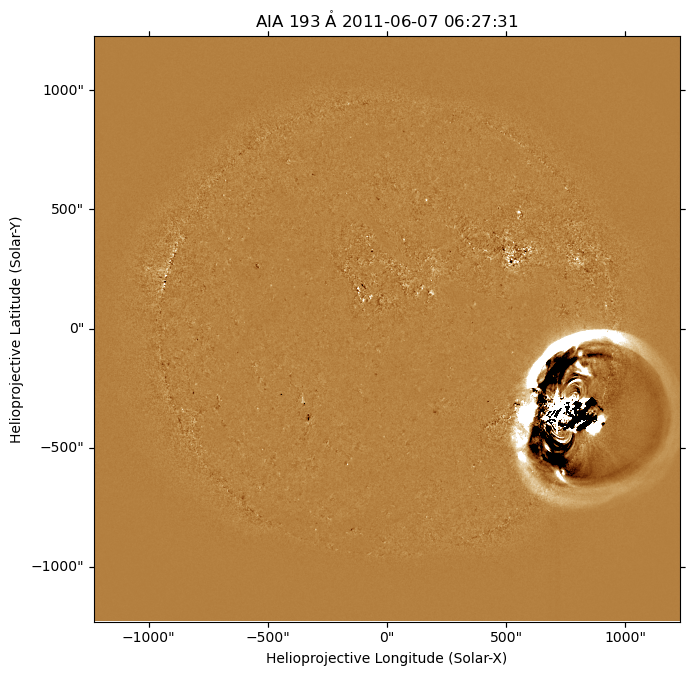

In [25]:
m = mseq_rdiff[52]

fig = plt.figure(figsize=[7,7])
ax  = fig.add_subplot(projection=m)
m.plot(axes=ax)
ax.grid(False)
fig.tight_layout()
plt.show()

## Fit ellipse on the coronal wave

In [26]:
# Assume you already have a SunPy Map `m`
nx, ny = m.dimensions.x.value, m.dimensions.y.value
dx = m.scale.axis1.value
dy = m.scale.axis2.value
x_min = -nx * dx / 2
x_max =  nx * dx / 2
y_min = -ny * dy / 2
y_max =  ny * dy / 2

theta = np.linspace(0, 2*np.pi, 300)

def plot_ellipse_on_map(x0, y0, a, b):
    plt.close('all')
    fig = plt.figure(figsize=[8,8])
    ax = fig.add_subplot(projection=m)
    m.plot(axes=ax)
    
    x_ell = x0 + a * np.cos(theta)
    y_ell = y0 + b * np.sin(theta)

    # try the pixel_to_world() function
    coords = SkyCoord(x_ell * u.arcsec,
                      y_ell * u.arcsec,
                      frame=m.coordinate_frame)
    ax.plot_coord(coords, color='red', lw=2)
    ax.set_title('Interactive Ellipse on AIA Map')
    plt.show()

# Sliders
layout = widgets.Layout(width='800px')
x_slider = widgets.FloatSlider(min=x_min, max=x_max, value=0, step=10,
                               description='X center', layout=layout)
y_slider = widgets.FloatSlider(min=y_min, max=y_max, value=0, step=10,
                               description='Y center', layout=layout)
a_slider = widgets.FloatSlider(min=1, max=(x_max - x_min)/2, value=200, step=10,
                               description='Semi-major', layout=layout)
b_slider = widgets.FloatSlider(min=1, max=(y_max - y_min)/2, value=100, step=10,
                               description='Semi-minor', layout=layout)

widgets.interact(plot_ellipse_on_map,
                 x0=x_slider, y0=y_slider,
                 a=a_slider, b=b_slider)

interactive(children=(FloatSlider(value=0.0, description='X center', layout=Layout(width='800px'), max=1228.8,…

<function __main__.plot_ellipse_on_map(x0, y0, a, b)>

In [27]:
# Extract the selected values
x_center = x_slider.value
y_center = y_slider.value
a_radius = a_slider.value
b_radius = b_slider.value

In [44]:
# ellipse_params = {
#     'x0': x_center,
#     'y0': y_center,
#     'a':  a_radius,
#     'b':  b_radius
# }

# print(ellipse_params)

{'x0': 861.2000000000005, 'y0': -378.79999999999984, 'a': 391.0, 'b': 391.0}


## Make a 3D ellipsoid from the fitting outputs

In [28]:
# Get the source coordinates of the coronal wave
from sunpy.net import attrs as a
from sunpy.net import Fido

tstart = '2011/06/07 06:00:00'
tend   = '2011/06/07 06:50:00'
event_type = 'CW'
result = Fido.search(a.Time(tstart,tend), a.hek.EventType(event_type))

In [29]:
tx = result['hek'][0]['hpc_x']
ty = result['hek'][0]['hpc_y']

print(tx, ty)

611 -355


In [30]:
tx = tx * u.arcsec
ty = ty * u.arcsec

In [31]:
# Define the HPC coordinate in arcsec
hpc_coord = SkyCoord(tx, ty, frame='helioprojective', observer=m.observer_coordinate, obstime=m.date)

# Convert to Heliographic Stonyhurst
hgs_coord = hpc_coord.transform_to('heliographic_stonyhurst')

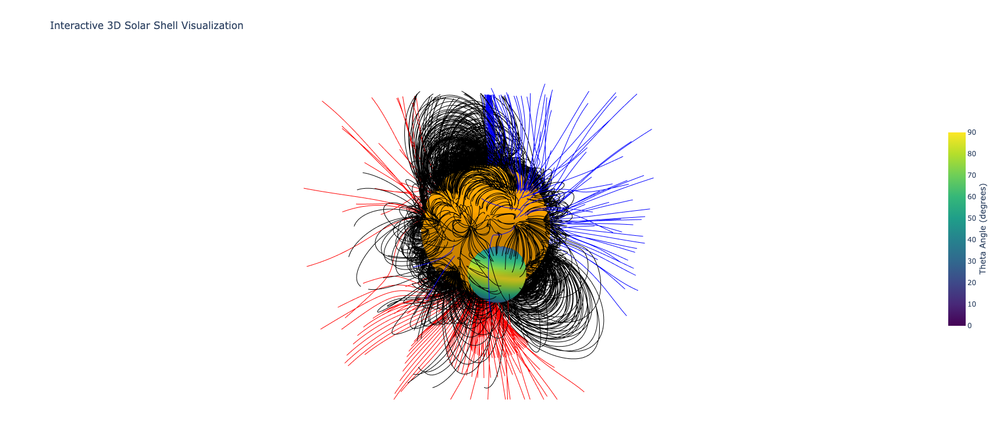

In [37]:
show_shell       = True
show_normals     = False
show_radials     = False
show_field_lines = True
show_axes        = False

fig = go.Figure()

# Create the Sun (sphere)
theta, phi = np.mgrid[0:np.pi:50j, 0:2*np.pi:50j]
x_sun = np.sin(theta) * np.cos(phi)
y_sun = np.sin(theta) * np.sin(phi)
z_sun = np.cos(theta)

fig.add_trace(go.Surface(
    x=x_sun, y=y_sun, z=z_sun,
    colorscale=[[0, 'orange'], [1, 'orange']],
    showscale=False,
    name='Sun',
    hoverinfo='skip'
))

# Convert shell center position to radians

shell_lon_deg = hgs_coord.lon.value
shell_lat_deg = hgs_coord.lat.value

shell_lon = np.deg2rad(shell_lon_deg)
shell_lat = np.deg2rad(shell_lat_deg)

xshift = np.cos(shell_lat) * np.cos(shell_lon)
yshift = np.cos(shell_lat) * np.sin(shell_lon)
zshift = np.sin(shell_lat)

# Create shell surface

shell_mesh_res = 50
b_major = a_radius / m.rsun_obs.value # convert to solar radii unit
b_minor = b_radius / m.rsun_obs.value # convert to solar radii unit

theta_src, phi_src = np.mgrid[0:np.pi:complex(shell_mesh_res), 0:2*np.pi:complex(shell_mesh_res)]
x_src = xshift + b_minor * np.sin(theta_src) * np.cos(phi_src)
y_src = yshift + b_minor * np.sin(theta_src) * np.sin(phi_src)
z_src = zshift + b_major * np.cos(theta_src)

r_shell = np.sqrt(x_src**2 + y_src**2 + z_src**2)
mask = r_shell > 1
x_outer = x_src[mask]
y_outer = y_src[mask]
z_outer = z_src[mask]

# Calculate normal vectors
a, b, c = b_minor, b_minor, b_major
nx = 2 * (x_outer - xshift) / (a**2)
ny = 2 * (y_outer - yshift) / (b**2)
nz = 2 * (z_outer - zshift) / (c**2)
norm = np.sqrt(nx**2 + ny**2 + nz**2)
nx /= norm
ny /= norm
nz /= norm

# Create display grid (with NaN inside the Sun)
x_display = np.copy(x_src)
y_display = np.copy(y_src)
z_display = np.copy(z_src)
r_display = np.sqrt(x_display**2 + y_display**2 + z_display**2)
x_display[r_display < 1] = np.nan
y_display[r_display < 1] = np.nan
z_display[r_display < 1] = np.nan

# Radial directions - always define for theta calculations
all_points = []
all_dirs = []

if show_radials:
    
    n_lat_radial = 50
    n_lon_radial = 50
    radial_length = 4
    
    theta_radial, phi_radial = np.mgrid[0:np.pi:complex(n_lat_radial), 0:2*np.pi:complex(n_lon_radial)]
    rdx = np.sin(theta_radial) * np.cos(phi_radial)
    rdy = np.sin(theta_radial) * np.sin(phi_radial)
    rdz = np.cos(theta_radial)
    rdx_flat = rdx.flatten()
    rdy_flat = rdy.flatten()
    rdz_flat = rdz.flatten()
    
    for i in range(len(rdx_flat)):
        r_vec = np.array([rdx_flat[i], rdy_flat[i], rdz_flat[i]])
        r_pts = np.linspace(0, radial_length, 50)
        lx = r_pts * r_vec[0]
        ly = r_pts * r_vec[1]
        lz = r_pts * r_vec[2]
        
        fig.add_trace(go.Scatter3d(
            x=lx, y=ly, z=lz,
            mode='lines',
            line=dict(color='gray', width=2),
            showlegend=False,
            hoverinfo='skip',
            opacity=0.3
        ))
        
        # Store points and directions for theta calculation
        for j in range(len(r_pts)-1):
            all_points.append([lx[j], ly[j], lz[j]])
            all_dirs.append(r_vec)
    
    all_points = np.array(all_points)
    all_dirs = np.array(all_dirs)


# Plot the magnetic field lines (placeholder - you'll need to add your field_lines data)
if show_field_lines:
    for n, field_line in enumerate(field_lines):
        color = {0:'black', -1:'blue', 1:'red'}.get(field_line.polarity)
        coords = field_line.coords
        coords.representation_type = 'cartesian'
        x_field = coords.x/const.radius
        y_field = coords.y/const.radius  
        z_field = coords.z/const.radius
        fig.add_trace(go.Scatter3d(
            x=x_field, y=y_field, z=z_field,
            mode='lines',
            line=dict(color=color, width=2),
            showlegend=False
        ))

    # Calculate theta angles between normal vectors and magnetic field lines
    # First, we need the field_lines data, and const.radius is the solar radius unit
    
    # Calculate field direction vectors (tangent to field line)
    for i in range(len(x_field)-1):
        # Field point
        field_point = np.array([x_field[i], y_field[i], z_field[i]])
        all_points.append(field_point)

        # Field direction (tangent vector)
        field_vector = np.array([x_field[i+1] - x_field[i], 
                                y_field[i+1] - y_field[i], 
                                z_field[i+1] - z_field[i]])
        # Normalize field vector
        field_vector = field_vector / np.linalg.norm(field_vector)
        all_dirs.append(field_vector)

    # Convert to arrays for downstream use
    all_points = np.array(all_points)
    all_dirs   = np.array(all_dirs)


# Calculate theta angles between normal vectors and radial directions
theta_angles = np.zeros_like(x_outer)

if len(all_points) > 0:
    for i, (x_pt, y_pt, z_pt) in enumerate(zip(x_outer, y_outer, z_outer)):
        surf_pt = np.array([x_pt, y_pt, z_pt])
        dists = np.linalg.norm(all_points - surf_pt, axis=1)
        idx = np.argmin(dists)
        radial_dir = all_dirs[idx]
        n_vec = np.array([nx[i], ny[i], nz[i]])
        cos_theta = np.dot(n_vec, radial_dir)
        cos_theta = np.clip(cos_theta, -1.0, 1.0)
        theta_angles[i] = np.degrees(np.arccos(np.abs(cos_theta)))
else:
    theta_angles[:] = np.nan

# Map theta to surface
theta_surface = np.full_like(x_src, np.nan)
valid = np.where(mask)
for i, (r_idx, c_idx) in enumerate(zip(*valid)):
    theta_surface[r_idx, c_idx] = theta_angles[i]

# Show shell with theta angle coloring
if show_shell:
    # Add shell center marker
    fig.add_trace(go.Scatter3d(
        x=[xshift], y=[yshift], z=[zshift],
        mode='markers',
        marker=dict(size=8, color='black'),
        showlegend=False,
        name='Shell Center'
    ))
    
    # Add shell surface with theta coloring
    fig.add_trace(go.Surface(
        x=x_display, y=y_display, z=z_display,
        surfacecolor=theta_surface,
        colorscale='Viridis',
        cmin=0, cmax=90,
        opacity=1,
        showscale=True,
        colorbar=dict(
            title=dict(text='Theta Angle (degrees)', side='right'),
            len=0.6
        ),
        name='Shell'
    ))


# Show normal vectors
if show_normals:
    # Sample normals to avoid too many arrows
    step = max(1, len(x_outer) // 100)  # Show max 100 arrows
    x_norm_sample = x_outer[::step]
    y_norm_sample = y_outer[::step]  
    z_norm_sample = z_outer[::step]
    nx_sample = nx[::step] * 0.2
    ny_sample = ny[::step] * 0.2
    nz_sample = nz[::step] * 0.2
    
    # Create line segments for normal vectors
    x_lines = []
    y_lines = []
    z_lines = []
    
    for i in range(len(x_norm_sample)):
        x_lines.extend([x_norm_sample[i], x_norm_sample[i] + nx_sample[i], None])
        y_lines.extend([y_norm_sample[i], y_norm_sample[i] + ny_sample[i], None])
        z_lines.extend([z_norm_sample[i], z_norm_sample[i] + nz_sample[i], None])
    
    fig.add_trace(go.Scatter3d(
        x=x_lines,
        y=y_lines,
        z=z_lines,
        mode='lines',
        line=dict(color='black', width=3),
        showlegend=False,
        name='Normal Vectors'
    ))


# Layout settings
fig.update_layout(
    scene=dict(
        xaxis=dict(range=[-2, 2], visible=show_axes),
        yaxis=dict(range=[-2, 2], visible=show_axes),
        zaxis=dict(range=[-2, 2], visible=show_axes),
        aspectmode='cube',
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=1.5)
        )
    ),
    width=1024,
    height=768,
    title='Interactive 3D Solar Shell Visualization',
    showlegend=False
)

fig.show()

In [3]:
from datetime import datetime

def parse_datetime_flex(dt_str, label):
    try:
        parts = dt_str.strip().split()
        assert len(parts) == 2, f'{label} must be "YYYY-MM-DD HH:MM[:SS]"'
        if len(parts[1].split(':')) == 2:
            dt_str += ':00'  # Add seconds if missing
        return datetime.strptime(dt_str, '%Y-%m-%d %H:%M:%S')
    except Exception:
        raise ValueError(f'Invalid {label}: "{dt_str}". Use format "YYYY-MM-DD HH:MM[:SS]"')


sdt = '2024-09-14 15:00'
start_dt = parse_datetime_flex(sdt, 'start_dt')
str(start_dt)

'2024-09-14 15:00:00'